## Importing the libraries

In [4]:
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sns
from PIL import Image
import tensorflow as tf
from keras.preprocessing import image

## Reference material  

CNN visuliazation approach explained through https://poloclub.github.io/cnn-explainer/ 

## Part 1 - Data Preprocessing

#### Step -1 `Image Augmentation Theory`

To rule out possibilities of overfitting the training set ,we can apply some random transformation.Image augmentation is a technique of applying different transformations to original images which results in multiple transformed copies of the same image. Each copy, however, is different from the other in certain aspects depending on the augmentation techniques you apply like `shifting`, `rotating`, `flipping`, etc.  

Applying these small amounts of variations on the original image does not change its target class but only provides a new perspective of capturing the object in real life.It not only expand the size of our dataset but also incorporate a level of variation in the dataset which allows your model to generalize better on unseen data. Also, the model becomes more robust when it is trained on new, slightly altered images.    

**So by these transformation we will make sure our model dont overlearn the subject.**

In [3]:
#(wid, height, 3) for RGB images. (3 is for 3 channels)
image_as_Array = plt.imread("image_dataset/training_dataset/crocodile/_129564775_gettyimages-108128106.jpg")
image_as_Array.shape

(549, 976, 3)

In [4]:
'''
Defining a Transformation function to view how randomly we get the transformed images everytime you run the code based 
on imput parameter that you defined.

.flow() method accept of tuple of 4 dims ,while we have image from .imread as 3 dims thats why we have added fake 1 dim  below
at starting of tuple.

And then by rotation if any pixel value is by chance converted into float ,converting it back into unit8 so that pixel value is interpretable by computer. 
'''

def augmented_imgs(image_aug,filepath,noOfTransformtoView):
    image_as_Array = np.expand_dims(plt.imread(filepath),axis=0)
    aug_imgs = image_aug.flow(image_as_Array,batch_size =1)
    fig,ax =plt.subplots(figsize=(25,25),nrows=1,ncols=noOfTransformtoView)
    # generate batch of images
    for i in range(noOfTransformtoView):
        # convert to unsigned integers
        image = next(aug_imgs)[0].astype('uint8')
        # plot image
        ax[i].imshow(image)
        ax[i].axis('off')
        
        
def view_transformation(image_aug,filepath,noOfTransformtoView,iterations):
    original_image = plt.imread(filepath)
    plt.imshow(original_image)
    plt.title("Original Image")
    plt.axis('off')
    # Iteration is how many times you want to make 3 random augmented image in real time
    for n in range(iterations):
        augmented_imgs(image_aug,filepath,noOfTransformtoView)
    
    

##### Types of Transformation

Option 1 :- Rotation
we can randomly rotate images through any degree between 0 and 360 by providing an integer value in the `rotation_range` argument.  

When the image is rotated, some pixels will move outside the image and leave an empty area that needs to be filled in.This is specified in the `fill_mode` argument and the default value is **“nearest”** which simply replaces the empty area with the nearest pixel values.

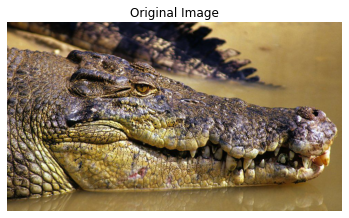

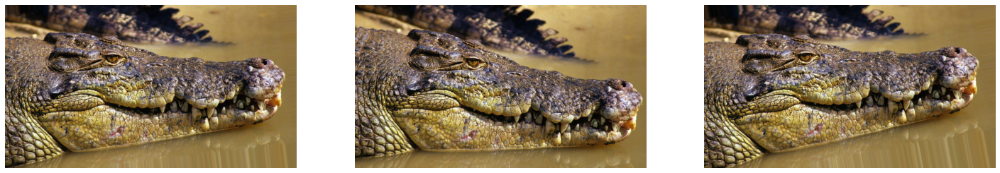

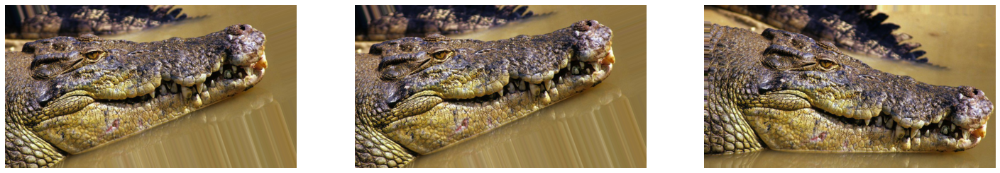

In [52]:
 # Iteration is how many times you want to make 3 random augmented image in real time
image_aug = image.ImageDataGenerator(rotation_range=22,fill_mode='nearest')
view_transformation(image_aug,"image_dataset/training_dataset/crocodile/_129564775_gettyimages-108128106.jpg",
                    noOfTransformtoView=3,iterations=2)


Option 2 :- Shifts  
It may happen that the object may not always be in the center of the image. To overcome this problem we can shift the pixels of the image either horizontally or vertically; this is done by adding a certain constant value to all the pixels.  

*Arguments*  
we can assign values to `height_shift_range` for a vertical shift of image and `width_shift_range` for a horizontal shift of image.If the value is a float number, that would indicate the percentage of width or height of the image to shift. Otherwise, if it is an integer value then simply the width or height are shifted by those many pixel values.

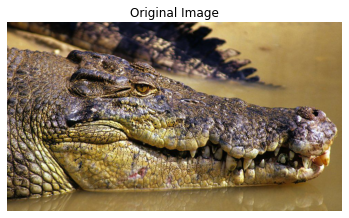

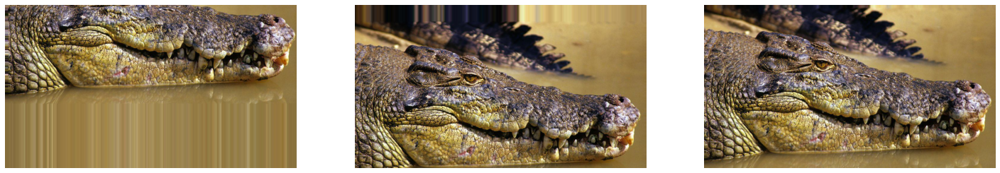

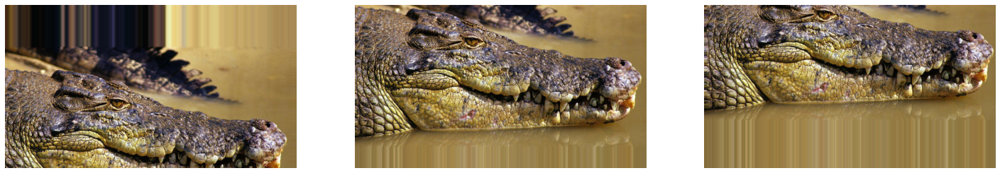

In [54]:
image_aug = image.ImageDataGenerator(height_shift_range=22,width_shift_range=0.22)  #notice that fill_mode is still nearest as it is default value
view_transformation(image_aug,"image_dataset/training_dataset/crocodile/_129564775_gettyimages-108128106.jpg",
                    noOfTransformtoView=3,iterations=2)

Option 3 :- Flips  
It has parameter's like `horizontal_flip` and `vertical_flip` for flipping along the vertical or the horizontal axis.  


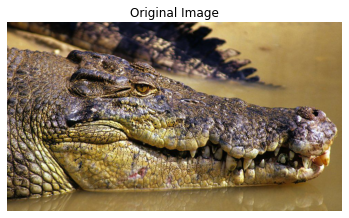

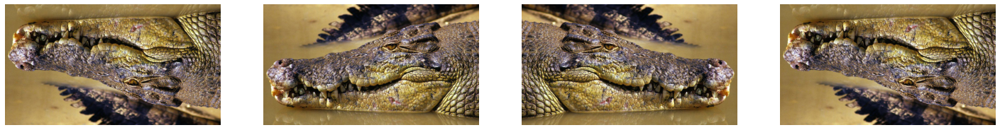

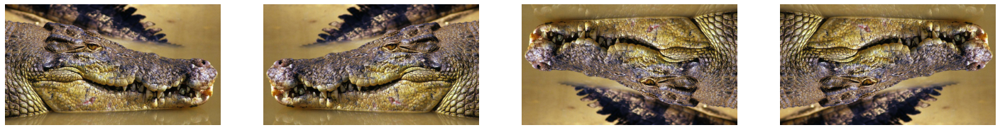

In [58]:
image_aug = image.ImageDataGenerator(horizontal_flip=True,vertical_flip=True)  #notice that fill_mode is still nearest as it is default value
view_transformation(image_aug,"image_dataset/training_dataset/crocodile/_129564775_gettyimages-108128106.jpg",
                    noOfTransformtoView=4,iterations=2)

Option 4 :- Zoom  
The zoom augmentation either randomly zooms in on the image or zooms out of the image.  

We have `zoom_range` argument where we can provide a list with two values specifying the lower and the upper limit. Else, if we specify a float value, then zoom will be done in the range **[1-zoom_range,1+zoom_range]**.Any value smaller than 1 will zoom in on the image. Whereas any value greater than 1 will zoom out on the image.

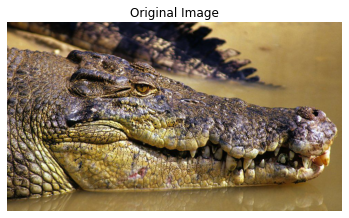

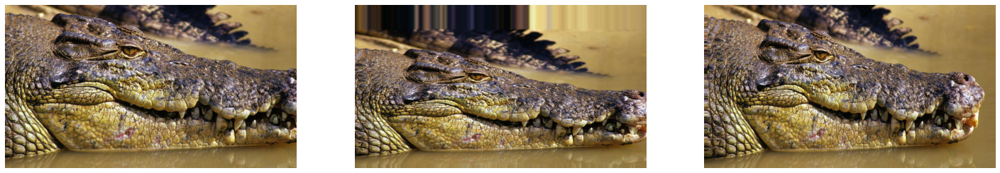

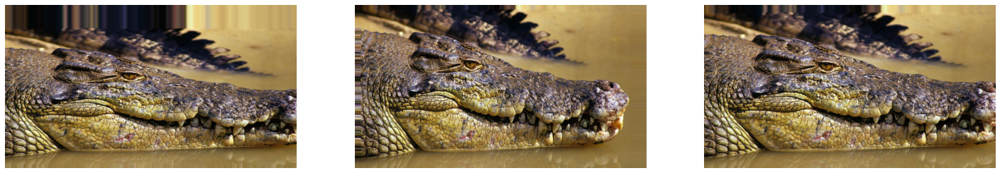

In [62]:
image_aug = image.ImageDataGenerator(zoom_range=0.22)  #notice that fill_mode is still nearest as it is default value

#range = [1-0.22,1+0.22]  therefore when <1 we get zoomedin, >1 we get zoomedout  
view_transformation(image_aug,"image_dataset/training_dataset/crocodile/_129564775_gettyimages-108128106.jpg",
                    noOfTransformtoView=3,iterations=2)

Option 5 :- brightness  
It randomly changes the brightness of the image.  
we have `brightness_range` argument which accepts a list of two float values or a tuple and picks a brightness shift value from that range. Values less than 1.0 darkens the image, whereas values above 1.0 brighten the image.

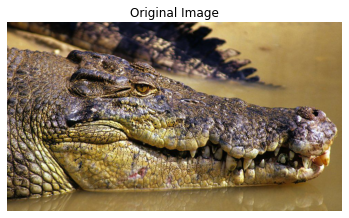

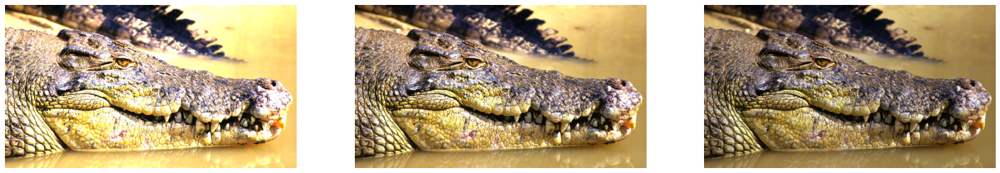

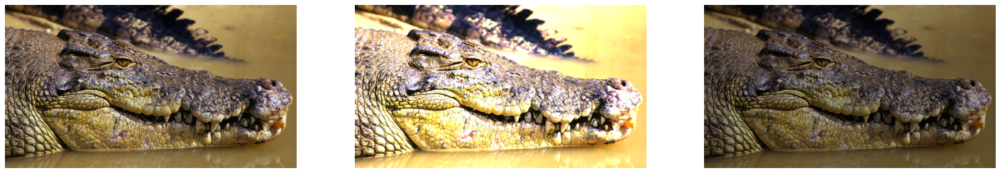

In [63]:
image_aug = image.ImageDataGenerator(brightness_range=[0.25,2.2])
view_transformation(image_aug,"image_dataset/training_dataset/crocodile/_129564775_gettyimages-108128106.jpg",
                    noOfTransformtoView=3,iterations=2)

#### Step -2 `Generating the training dataset`

we will apply all the 5 transformation above along with feature scaling of each pixel for our training dataset.

In [5]:
train_datagen = image.ImageDataGenerator(
                                   rescale =1./255,
                                   rotation_range=22,
                                   fill_mode='nearest',
                                   height_shift_range=22,
                                   width_shift_range=0.22,
                                   horizontal_flip=True,
                                   vertical_flip=True,
                                   zoom_range = 0.22,
                                   brightness_range=[0.25,2.2],
                                   )
#rescale =1./255

The `flow_from_directory()` method allows you to read the images directly from the directory and augment them while the neural network model is learning on the training data.The method expects that images belonging to different classes are present in different folders but are inside the same parent folder. 

*Note* :- when we apply  these image augmentation,it augments new images in real time and not store them in original path,therby saving space and also it loads image in batches (epoch as we say)

In [6]:
training_set = train_datagen.flow_from_directory('image_dataset/training_dataset',
                                                 target_size = (256, 256), #resizing all our image to one size which we will fed to CNN model
                                                 batch_size = 32,        #at a time it loads 32 images
                                                 class_mode = 'binary',   #crocodile or woods
                                                 shuffle=True
                                                 )     

training_set.class_indices

Found 4252 images belonging to 2 classes.


{'crocodile': 0, 'logs': 1}

So if we want to see how batch_size works we will see the visuliazation for first 5 iteration.Since batch_size is 32 ,so everytime we call next() we get that many images.

`Note :- If you want to run the below visulaization code then dont apply feature scaling aka "rescale" because when we apply normalization its value will be between 0 and 1 and we cant visulaize it as it will appear black because image function treat that as directly pixel value and 0 represnt black while 255 represents white.`

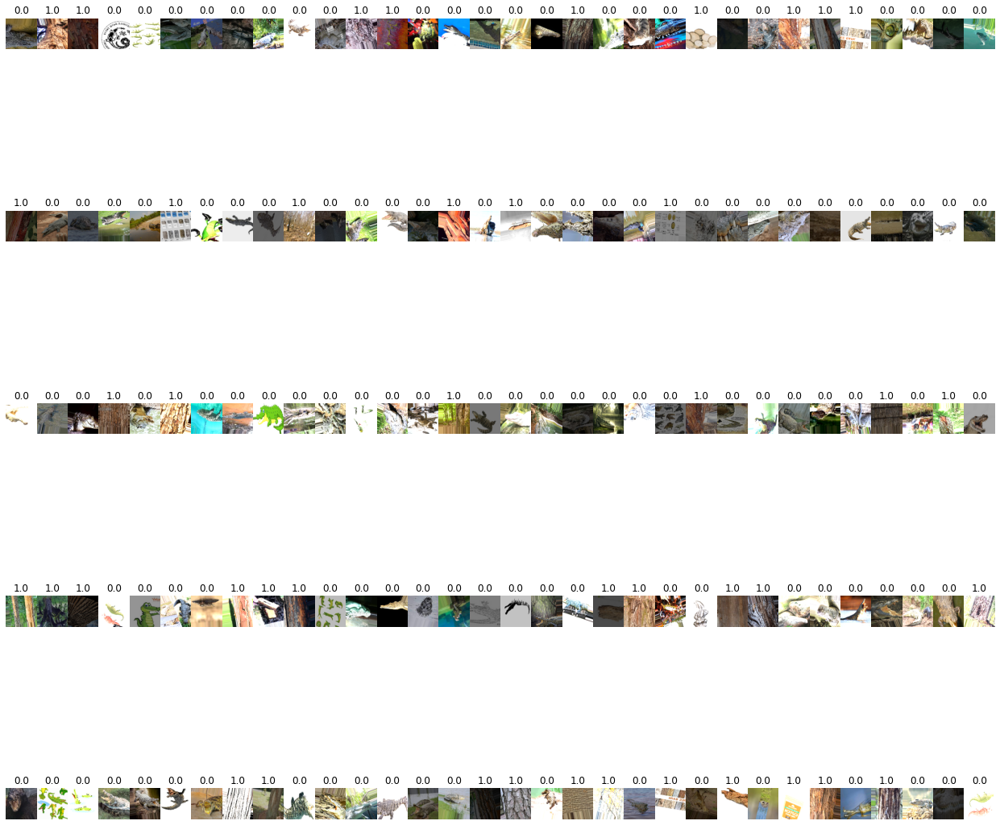

In [98]:
rows=5
fig,ax = plt.subplots(nrows=rows,ncols=32,gridspec_kw={'wspace':0,'hspace':0}) #cols = batch_size we have assigned

for row in range(rows):
    img_batch = training_set.next()
    #creates a tensor of dims ((32, 128, 128, 3) , 0 or 1) where o or 1 represent image is from which class 
    #a tensor of dims (32, 128, 128, 3) representing noOfImg,width,height,color channels
    img_count = img_batch[0].shape[0]
    for i in range(img_count):
        img = img_batch[0][i].astype('uint8')
        ax[row,i].imshow(img)
        ax[row,i].title.set_text(img_batch[1][i])      # so to know from which class image is been rendered
        ax[row,i].axis('off')
fig.set_size_inches(22,22) 

# let say we have 1275 images => 1275/32 = 39.85  therfore in 40th batch (1275-1248)= last 27 will be empty as no new image to be read
#but after that again new iterations starts from beginning.        

In our example, we have let say 1275 images in total for training set. And so in each epoch, the `ImageDataGenerator` class will transform all the 1275 images for training. In each epoch the model will get different variations of the images. If you have 25 epoch, then in total `25x1275 variations` of the images will be generated and fed into the training model.

#### Step -3 `Generating the testing/Validation dataset`

Not applying any image transformation like training set as we are validating our model accuracy by cross validating with actual image (i.e supervised learning)

In [7]:
test_datagen = image.ImageDataGenerator(rescale=1./255)
test_set = test_datagen.flow_from_directory('image_dataset/test_dataset',
                                            target_size = (256, 256), #resizing all our image to one size which we will fed to CNN model
                                            batch_size = 32,        #at a time it loads 32 images
                                            class_mode = 'binary',   #crocodile or woods
                                            shuffle=True,
                                            )

Found 1656 images belonging to 2 classes.


## Part 2 - Building the model

#### Step -1 Defining the model

In [8]:
cnn = tf.keras.models.Sequential()

#### Step -2 Convolutional + RelU layer

for theory of how convolution is applied with the help of feature detector/kernel/filter, check Deep learning notebook pg 39.

For example for image of size (64,64,3) ,and kernel size of 3x3 we get output image = (62,62) for each color channel seperate image we get 

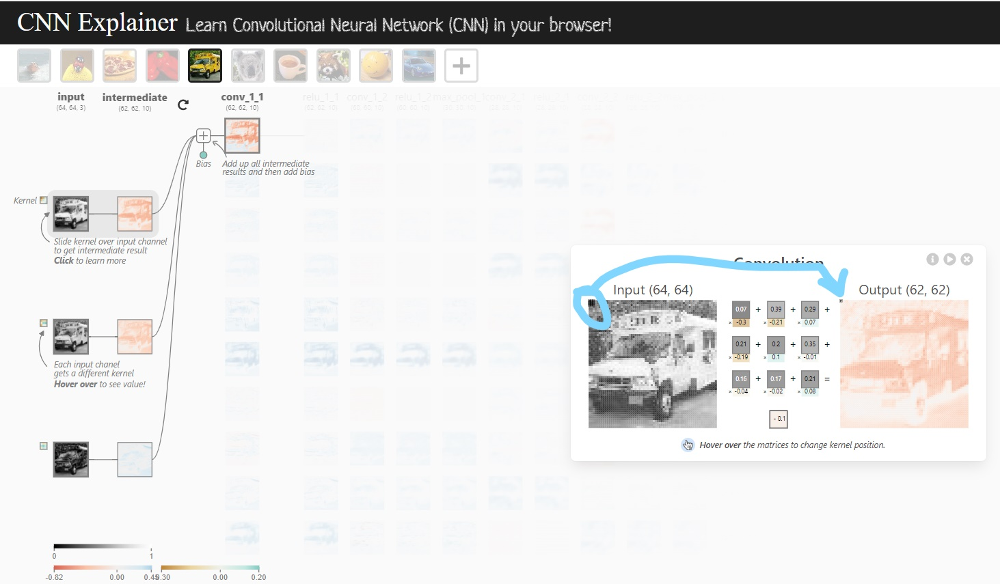

In [14]:
from IPython import display
display.Image("E:\\Machine Learning\\Projects\\meWhoObserves\\Screenshot (128).jpg")

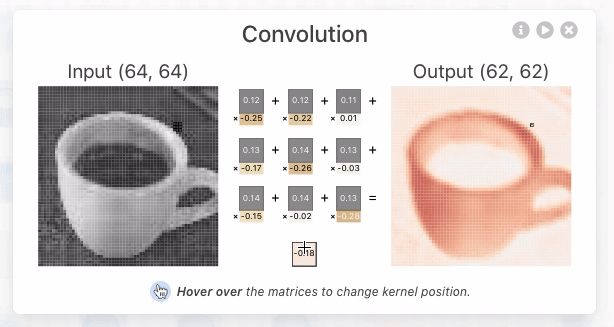

In [19]:
display.Image("E:\\Machine Learning\\Projects\\meWhoObserves\\convlayer_detailedview_demo.gif")

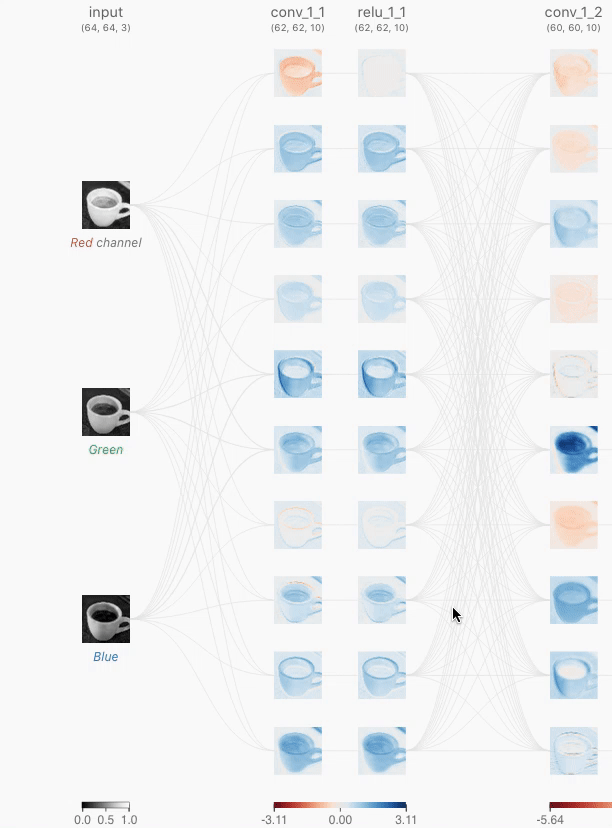

In [18]:
display.Image("E:\\Machine Learning\\Projects\\meWhoObserves\\convlayer_overview_demo.gif")

And therafter we apply relu function which is nothing but transformation for which value less then zero gives output zero and for greater then zero it gives max of both the given value.  


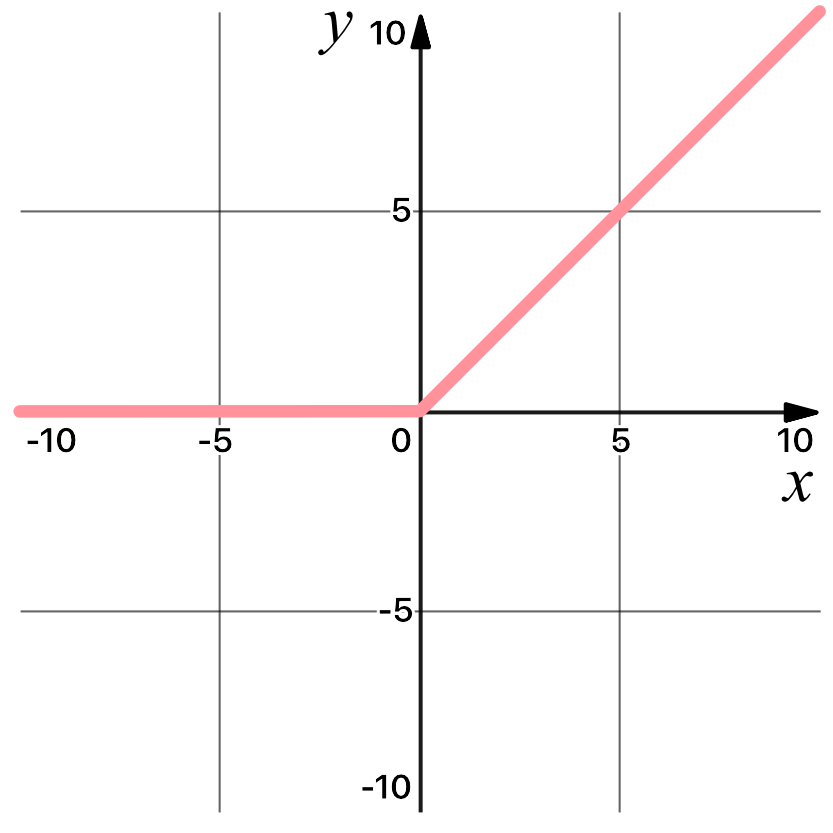

In [17]:
display.Image("E:\\Machine Learning\\Projects\\meWhoObserves\\relu_graph.png")

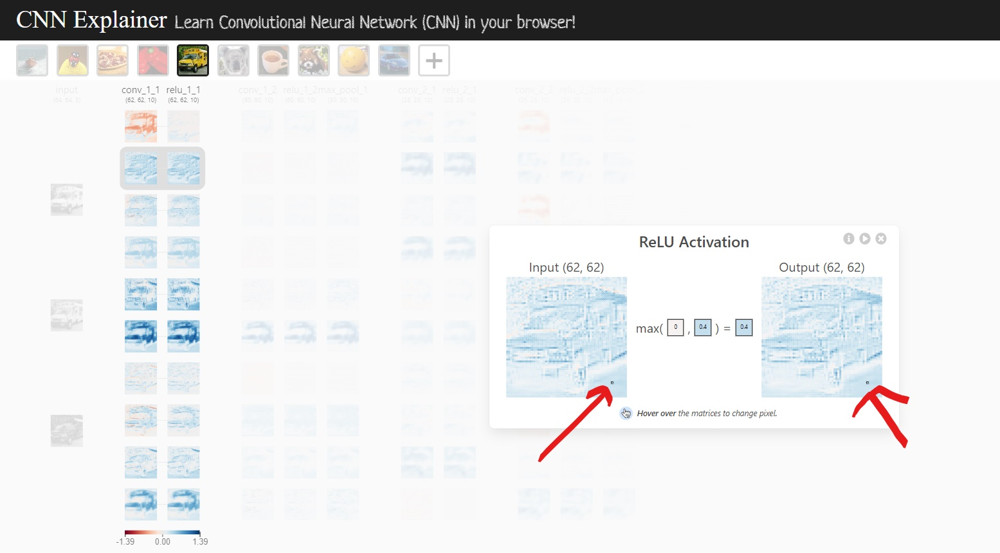

In [9]:
display.Image("E:\\Machine Learning\\Projects\\meWhoObserves\\Screenshot (129).jpg")

In [9]:
cnn.add(tf.keras.layers.Conv2D(
                               filters=25,                #no of diff kernels/feature detectors
                               kernel_size= (3,3),        #3x3 matrix dim of each kernel
                               activation = 'relu',         
                               input_shape = [256,256,3],  #for our neural network this will be the first layer so need to specify the input shape
                                                          #it should be equal to target_size set in training_set
                               name="First_Conv_layer"   
                               ))

#### Step -3 Pooling layer

now we get 35 diff feature maps and we will further applying max pooling to account for spatial variance and reduce overfitting, and also to reduce the image size,so to decrease the processing time.  

For example:- our input shape  is `(128,128,3)` so after convolution it will become `(126,126,35)` where `35` is no of diff filter we have chosen so `35 different feature map` we get and therafter when we apply pooling it will be reduced to half the size as we are converting four pixel value into single value by applying max value and also `strides =2` so no overlapping of rows and column applied thats why output shape will become `(63,63,35)`.You can cross verify below in summary section of model.

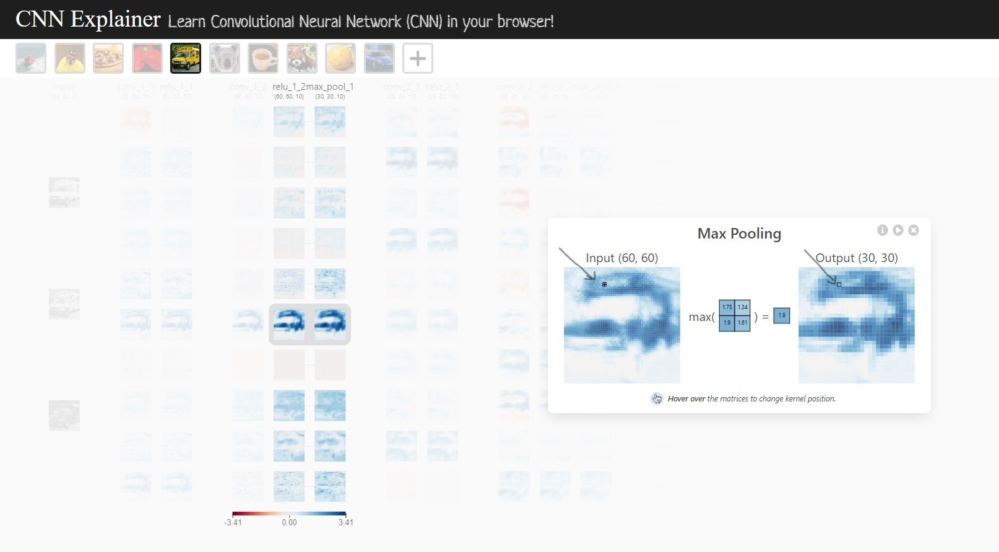

In [10]:
display.Image("E:\\Machine Learning\\Projects\\meWhoObserves\\Screenshot (130).jpg")

In [10]:
cnn.add(tf.keras.layers.MaxPool2D( 
                                  pool_size=(2,2),      # creating 2x2 pooling window 
                                  strides=2,             # no of pixels we want to shift our pooling window horizontally and vertically
                                  name="First_Pooling_layer"
                                  ))

#### Step -4 Second Conv and Pooling Layer

considering our example we will have `(63,63,35)` ,35 distinct pooled feature map with us and now when we apply convolution with kernel size = 3x3 we will get output of `(61,61,40)`as for second layer we have chosen 40 different filters ,and therafter applying max pooling for same window size of 2x2 with strides =2 we get ouput size reduced to `(30,30,40)`.Cross verify below in summary section

In [11]:
cnn.add(tf.keras.layers.Conv2D( 
                               filters=25,
                               kernel_size=3,
                               activation='relu',
                               name="Second_Conv_layer" 
                               )
        )
#not needed input_shape parameter here as this get input from prev build layer and not from raw dataset

cnn.add(tf.keras.layers.MaxPool2D( 
                                  pool_size=2,
                                  strides=2,
                                  name="Second_Pooling_layer" 
                                  )
       )

#### Step -5 Flattening

we flatten our pooled feature map generated from prev layer pooling process into 1D array.We can consider this as our Artifivcial neural network input layer consisiting of neurons (each becomes a feature to be learned by model)

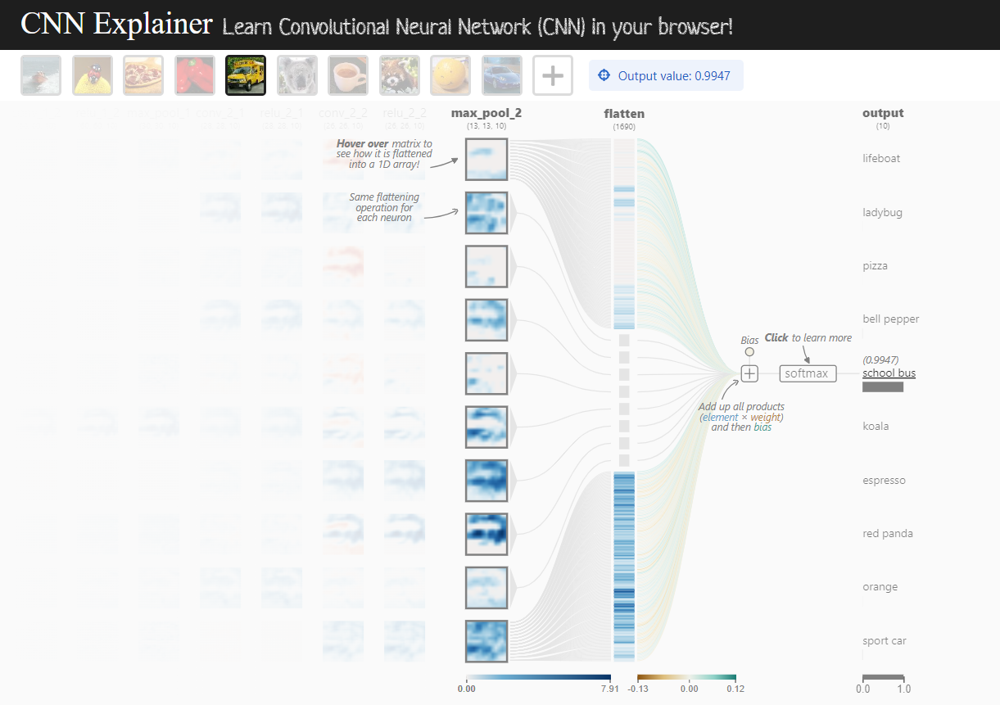

In [14]:
display.Image("E:\\Machine Learning\\Projects\\meWhoObserves\\Screenshot (132).png")

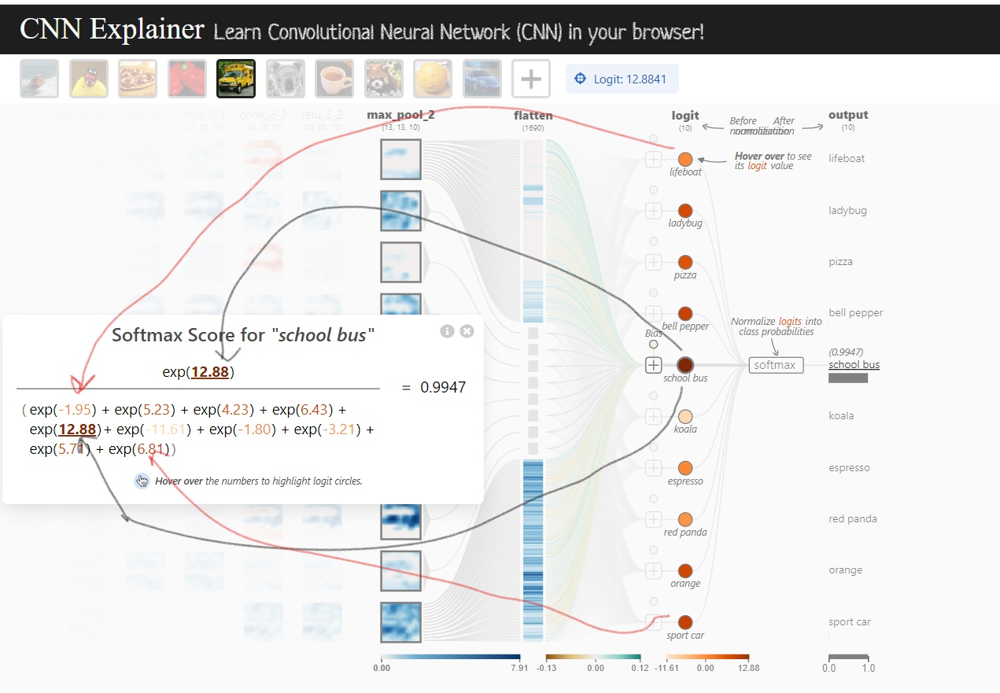

In [16]:
display.Image("E:\\Machine Learning\\Projects\\meWhoObserves\\Screenshot (133).jpg")
#here we can see how softmax function accounts for probability of each class

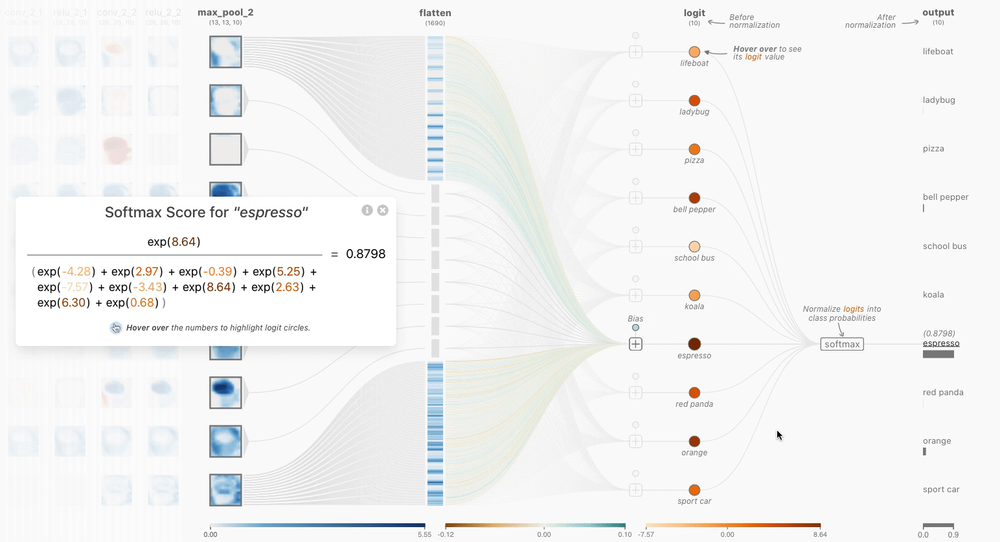

In [20]:
display.Image("E:\\Machine Learning\\Projects\\meWhoObserves\\softmax_animation.gif")

In [12]:
cnn.add(tf.keras.layers.Flatten(name="Flatten_layer"))

For our example output of second layer after max pooling was `(30,30,40)` so converting it into single dimension of neurons = 30x30x40 = `36000 neurons` will be there

#### Step -6 Hidden Layer  
Full connection in terms of CNN terminology

In [13]:
cnn.add(tf.keras.layers.Dense(units=56,activation='relu',name="first_hidden_layer"))

#### Step -7 Output Layer

In [14]:
# as we have only 2 class corocodile or log therfore one neuron will be sufficient to intrepret it
#softmax would be better activation function if there are more then 1 class
cnn.add(tf.keras.layers.Dense(units=1,activation='sigmoid',name='Output_layer'))

## Part 3 Compiling the model

we will use binary_crossentropy as cost/loss function ,check theory at  
 https://www.analyticsvidhya.com/blog/2021/10/a-comprehensive-guide-on-deep-learning-optimizers/

In [15]:
cnn.compile( 
            optimizer= 'adam',
            loss = "binary_crossentropy",
            metrics=['accuracy'] 
            )

`Model Summary of layers being set`

In [16]:
cnn.summary()

Model: "sequential"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 First_Conv_layer (Conv2D)   (None, 254, 254, 25)      700       
                                                                 
 First_Pooling_layer (MaxPo  (None, 127, 127, 25)      0         
 oling2D)                                                        
                                                                 
 Second_Conv_layer (Conv2D)  (None, 125, 125, 25)      5650      
                                                                 
 Second_Pooling_layer (MaxP  (None, 62, 62, 25)        0         
 ooling2D)                                                       
                                                                 
 Flatten_layer (Flatten)     (None, 96100)             0         
                                                                 
 first_hidden_layer (Dense)  (None, 56)                5

`Keras appends an extra dimension to our tensor i.e None in first dimesnion which corresponds to the batch size,since it is defined while training so it is none here.`

## Part 4 Training our model

we will train our model on training set and validate through test set to adjust the parameter of cnn layers

`How epoch works?`  
In our example, we have let say 1275 images in total for training set. And so in each epoch, the `ImageDataGenerator` class will transform all the 1275 images for training. In each epoch the model will get different variations of the images. If you have 25 epoch, then in total `25x1275 variations` of the images will be generated and fed into the training model.

In [17]:
# Add timestamp
import datetime
print(f"Notebook last run (end-to-end): {datetime.datetime.now()}")

Notebook last run (end-to-end): 2023-07-11 00:09:17.650519


## Setting up callbacks (things to run whilst our model trains)  
[Callbacks](https://www.tensorflow.org/api_docs/python/tf/keras/callbacks) are extra functionality we can add to our models to be performed during or after training. Some of the most popular callbacks include:
* [**Experiment tracking with TensorBoard**](https://www.tensorflow.org/api_docs/python/tf/keras/callbacks/TensorBoard) - log the performance of multiple models and then view and compare these models in a visual way on [TensorBoard](https://www.tensorflow.org/tensorboard) (a dashboard for inspecting neural network parameters). Helpful to compare the results of different models on your data.
* [**Model checkpointing**](https://www.tensorflow.org/api_docs/python/tf/keras/callbacks/ModelCheckpoint) - save our model as it trains so you can stop training if needed and come back to continue off where you left. Helpful if training takes a long time and can't be done in one sitting.
* [**Early stopping**](https://www.tensorflow.org/api_docs/python/tf/keras/callbacks/EarlyStopping) - leave our model training for an arbitrary amount of time and have it stop training automatically when it ceases to improve. Helpful when we have a large dataset and don't know how long training will take.

The TensorBoard callback can be accessed using [`tf.keras.callbacks.TensorBoard()`](https://www.tensorflow.org/api_docs/python/tf/keras/callbacks/TensorBoard). 

Its main functionality is saving a model's training performance metrics to a specified `log_dir`.

By default, logs are recorded every epoch using the `update_freq='epoch'` parameter. This is a good default since tracking model performance too often can slow down model training.

To track our modelling experiments using TensorBoard, let's create a function which creates a TensorBoard callback for us.

In [18]:

def create_tensorboard_callback(dir_name, experiment_name):
  log_dir = dir_name + "/" + experiment_name + "/" + datetime.datetime.now().strftime("%Y%m%d-%H%M%S")
  tensorboard_callback = tf.keras.callbacks.TensorBoard(
      log_dir=log_dir
  )
  print(f"Saving TensorBoard log files to: {log_dir}")
  return tensorboard_callback

Because we are likely to run multiple experiments, it's a good idea to be able to track them in some way.

In our case, our function saves a model's performance logs to a directory named `[dir_name]/[experiment_name]/[current_timestamp]`, where:
* `dir_name` is the overall logs directory
* `experiment_name` is the particular experiment
* `current_timestamp` is the time the experiment started based on Python's [`datetime.datetime().now()`](https://docs.python.org/3/library/datetime.html#datetime.datetime.now)

In [19]:
cnn_history = cnn.fit(x=training_set,validation_data=test_set,epochs=11,
                      # Adding TensorBoard callback to model (callbacks parameter takes a list)
                      callbacks=[create_tensorboard_callback(dir_name="E:\\Machine Learning\\Projects\\meWhoObserves\\tensorflowLogs",
                                                             experiment_name="cnn_from_scratch")]
                      
                      )

Saving TensorBoard log files to: E:\Machine Learning\Projects\meWhoObserves\tensorflowLogs/cnn_from_scratch/20230711-000927
Epoch 1/11
133/133 [==============================] - 465s 3s/step - loss: 0.7302 - accuracy: 0.6000 - val_loss: 0.6009 - val_accuracy: 0.6793
Epoch 2/11
133/133 [==============================] - 358s 3s/step - loss: 0.5867 - accuracy: 0.7013 - val_loss: 0.5348 - val_accuracy: 0.7446
Epoch 3/11
133/133 [==============================] - 312s 2s/step - loss: 0.5746 - accuracy: 0.7081 - val_loss: 0.5414 - val_accuracy: 0.7047
Epoch 4/11
133/133 [==============================] - 313s 2s/step - loss: 0.5553 - accuracy: 0.7227 - val_loss: 0.6035 - val_accuracy: 0.6359
Epoch 5/11
133/133 [==============================] - 311s 2s/step - loss: 0.5301 - accuracy: 0.7333 - val_loss: 0.5393 - val_accuracy: 0.7349
Epoch 6/11
133/133 [==============================] - 310s 2s/step - loss: 0.5146 - accuracy: 0.7502 - val_loss: 0.4409 - val_accuracy: 0.8074
Epoch 7/11
133/133

## Plot Loss Curves

When a model's **validation loss starts to increase**, it's likely that it's overfitting the training dataset. This means, it's learning the patterns in the training dataset *too well* and thus its ability to generalize to unseen data will be diminished.

### Approach -1  How to access tensorboard?? (usefult to visualize all models at once)

Usually `%tensorboard dev upload --logdir =""` works  but here in vscode i am not able to change the log directory path for inbuilt tensorboard.Thats why logs are saved in default directory i.e (E:\Machine Learning\Udemy - The Data Science Course(365careerteam)\Udemy - The Data Science Course(365careerteam)) and **tensorflowLogs** folder is created for it to store diff models logs.  

To access the tensorboard  
- press `ctrl+shift+p` and search tensorboard and thereafter "select option use current directory"
- or else in below cell press play button where `Launch Tensorboard Session` is written  

In [20]:
import tensorboard


In [30]:
# Upload TensorBoard dev records
%tensorboard dev upload --logdir ="E:\\Machine Learning\\Projects\\meWhoObserves\\tensorflowLogs"

UsageError: Line magic function `%tensorboard` not found.


### Approach -2 Using custom function (everytime you will have to call it for each model you will test)

In [21]:
# Plot the loss and accuracy plot seperately

def plot_loss_curves(history):
  """
  Returns separate loss curves for training and validation metrics.
  """ 
  loss = history.history['loss']
  val_loss = history.history['val_loss']

  accuracy = history.history['accuracy']
  val_accuracy = history.history['val_accuracy']

  epochs = range(len(history.history['loss']))

  # Plot loss
  fig,ax = plt.subplots(nrows=1,ncols=2,figsize=(20,8))
  ax[0].plot(epochs, loss, label='training_loss')
  ax[0].plot(epochs, val_loss, label='val_loss')
  ax[0].title.set_text('Loss')
  ax[0].legend()

  # Plot accuracy
  ax[1].plot(epochs, accuracy, label='training_accuracy')
  ax[1].plot(epochs, val_accuracy, label='val_accuracy')
  ax[1].title.set_text('Accuracy')
  ax[1].legend();
  
  for x in ax.flat:
    x.set(xlabel='Epochs')

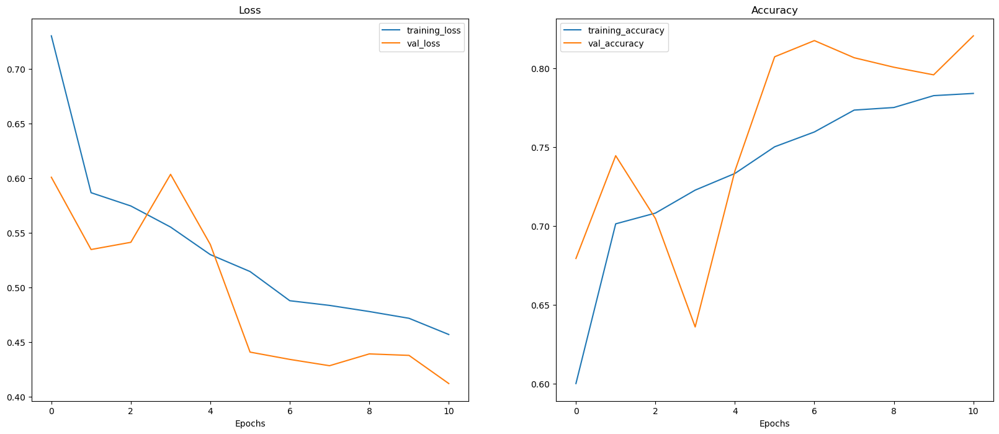

In [22]:
plot_loss_curves(cnn_history)

We can observes that training and validation curves are not behaving same ,they should mimic behaviour but here it does not that means we need to hypertune some parameter our change the layers parameter in order to achieve smooth curves.

`Note :- after hypertuning layer we finally got above plots .See tensorboard to track every model we run till now.`

## Making a Single Prediction

In [23]:
#making a list out of possible outcome for our input image
class_names = [v for v in training_set.class_indices] 
class_names   

['crocodile', 'logs']

Before we fed our image to model ,we need to apply the same transformation (i.e feature scaling,input shape and color channels) that we defined for our training dataset for cnn model.Therfore creating function for same.

In [24]:
#img_path :- input image path as str
#img_shape :- input image shape except color channel as List i.e here [128,128]

def transform_image_for_prediction(img_path,img_shape):
  """
  Reads an image from filename, turns it into a tensor
  and reshapes it to (img_shape, img_shape, colour_channel).
  """
  # Read in target file (an image)
  img = tf.io.read_file(img_path)
  
  # Decode the read file (array) into a tensor & ensure 3 colour channels 
  # (our model is trained on images with 3 colour channels and sometimes images have 4 colour channels)
  img = tf.image.decode_image(img, channels=3)
  
  # Resize the image (to the same size our model was trained on)
  img = tf.image.resize(img,size=img_shape)
  
  #Applying Feature scaling as we done it /255. in our training and test data
  img = img/255.                 #dot at end of 255 so to convert integer into float value 
  
  return img 

In [25]:

"""
  ********************INPUT PARAMETERS***********************************************
  model       :- pass in fitted model 
  img_path    :- input image path as str
  img_shape   :- input image shape except color channel as List i.e here [128,128]  (will be defined in Conv first layer)
  class_names :- list containing all possible ouptut value i.e [crocodile,logs]
  ***********************************************************************************
"""

def make_prediction(model,img_path,img_shape,class_names):
  """
  Imports an image located at filename, makes a prediction on it with
  a trained model and plots the image with the predicted class as the title.
  """
  
  # Import the target image and preprocess it
  img = transform_image_for_prediction(img_path,img_shape)
  
  # Make a prediction
  pred_prob = model.predict(tf.expand_dims(img, axis=0))         #adding fake dimension which represnts batchno
  #gives ouput as [[0.20958365]] because one input image and binary classification otherwise [[0.22,0.32,0.50]] for one image ,3 classification value
  
  print("Prediction Probability:",pred_prob)
  print(f"Prediction of being crocodile: {np.round(((1-pred_prob[0][0])*100),2)}%")
  print(f"Prediction of being driftwood: {np.round(((pred_prob[0][0])*100),2)}%")
  print(f"Round value refers to classes as :{training_set.class_indices}")
  
  
  # Get the predicted class
  if len(pred_prob[0]) > 1: # prediction for multi-class
    pred_class = class_names[pred_prob.argmax()] # if more than one output, take the max
  else:                #prediction for binary class
    if (pred_prob[0][0] >=0.60):
      i=1
    else:
      i=0
    pred_class = class_names[i] # if only one output, round
    
  # Plot the image and predicted class
  plt.imshow(img)
  plt.title(f"Prediction: {pred_class}")
  plt.axis(False);  

1/1 [==============================] - 0s 254ms/step
Prediction Probability: [[0.13205968]]
Prediction of being crocodile: 86.79%
Prediction of being driftwood: 13.21%
Round value refers to classes as :{'crocodile': 0, 'logs': 1}


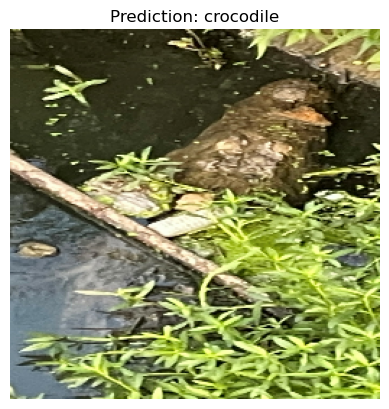

In [26]:
make_prediction(cnn,"E:\Machine Learning\Projects\meWhoObserves\image_dataset\predict\IMG_4308.jpg",
                img_shape= [256,256],class_names=class_names)

## Part 5 - Using google highly efficient proven model for image classification from tensorflow_hub 

In [1]:
#append here link to google colab because here in vscode hub package is not working

<a href="https://colab.research.google.com/drive/1pBriarglsyCrs60PAMzDvnxg28XeGV3K?usp=sharing" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>